In [1]:
# %matplotlib widget
%load_ext autoreload
%autoreload 2
import os
import sys
sys.path.append("/home/ipausers/lin/Desktop/AMF/AMFtrack")
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import random
import numpy as np
import json
import imageio
import logging
import cv2
from skimage.measure import profile_line

from amftrack.pipeline.functions.image_processing.experiment_class_surf import (
    Experiment,
    Node,
    Edge,
)
from amftrack.pipeline.functions.image_processing.experiment_util import (
    plot_full_image_with_features,
    get_all_edges,
    get_all_nodes,
    plot_full,
    reconstruct_image_from_general,
)
from amftrack.pipeline.functions.image_processing.experiment_util import (
    get_random_edge,
    distance_point_edge,
    plot_edge,
    plot_edge_cropped,
    find_nearest_edge,
    get_edge_from_node_labels,
    plot_full_image_with_features,
    get_all_edges,
    get_all_nodes,
    find_neighboring_edges,
    reconstruct_image,
    reconstruct_skeletton_from_edges,
    reconstruct_skeletton_unicolor,
    plot_edge_width,
    plot_full,
)

from amftrack.util.sys import get_current_folders, update_plate_info, test_path
from amftrack.util.plot import show_image
from amftrack.util.sys import storage_path
from amftrack.util.geometry import (
    generate_index_along_sequence,
    centered_bounding_box,
    expand_segment,
    get_section_segment,
    compute_factor,
    generate_index_along_sequence,
    distance_point_pixel_line,
    get_closest_lines,
    get_closest_line_opt,
    intersect_rectangle,
    is_overlapping,
    get_overlap,
    format_region,
    is_in_bounding_box,
    get_bounding_box,
    centered_bounding_box,
)
from amftrack.util.image_analysis import (
    find_transformation,
    get_transformation,
    reverse_transformation,
    convert_to_micrometer,
    find_image_index,
    is_in_image,
    extract_inscribed_rotated_image,
    is_negative_similarity,
    find_similarity,
    find_scaling_factor,
)
from amftrack.util.geometry import generate_index_along_sequence
from amftrack.pipeline.functions.image_processing.extract_width_fun import (
    compute_edge_width_profile,
    extract_section_profiles_for_edge,
)
import sys
import matplotlib.pyplot as plt
sys.path.append("/home/ipausers/lin/Desktop/Kai//Graduation-Project")
from models.make_dataset import *
from models.config import *
from models.model import *

/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/util/dbx.py:3: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm
2023-02-06 17:59:01.615439: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-06 17:59:01.720680: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/ipausers/lin/Desktop/Graduation/project/lib/python3.8/site-packages/cv2/../../lib64:
2023-02-06 17:59:01.720697: I tensorflow/stream_executor/cuda/cudart_stu

# check plate 521 - day1

## create dataset

In [3]:
directory_groundtruths = os.path.join(storage_path,'old')
directory = directory_groundtruths+"/"
update_plate_info(directory)

analysed:   0%|          | 0/3 [00:00<?, ?it/s]

In [4]:
folder_df = get_current_folders(directory)
folder_df

,total_path,Plate,PrincePos,root,strain,medium,split,Pbait,CrossDate,Temperature,...,/Analysis/transform.mat,/Analysis/transform_corrupt.mat,/Analysis/skeleton_realigned_compressed.mat,/Analysis/nx_graph_pruned.p,/Analysis/nx_graph_pruned_width.p,/Analysis/nx_graph_pruned_labeled.p,date,folder,unique_id,datetime
0,/home/ipausers/lin/Desktop/data/old/20230111_1...,521,2,'Carrot','C2','001P100N100C','Y','-',20230104,25,...,True,False,True,True,True,True,"11.01.2023, 13:49:",20230111_1349_Plate02,521_20230104,2023-01-11 13:49:00
1,/home/ipausers/lin/Desktop/data/old/20230109_1...,521,2,'Carrot','C2','001P100N100C','Y','-',20230104,25,...,True,False,True,True,True,True,"09.01.2023, 14:09:",20230109_1409_Plate02,521_20230104,2023-01-09 14:09:00
2,/home/ipausers/lin/Desktop/data/old/20230113_0...,521,2,'Carrot','C2','001P100N100C','Y','-',20230104,25,...,True,False,True,True,True,True,"13.01.2023, 09:49:",20230113_0949_Plate02_re,521_20230104,2023-01-13 09:49:00


In [5]:
select = folder_df[(folder_df["Plate"] == "521") & (folder_df["folder"] == "20230109_1409_Plate02")]
select

,total_path,Plate,PrincePos,root,strain,medium,split,Pbait,CrossDate,Temperature,...,/Analysis/transform.mat,/Analysis/transform_corrupt.mat,/Analysis/skeleton_realigned_compressed.mat,/Analysis/nx_graph_pruned.p,/Analysis/nx_graph_pruned_width.p,/Analysis/nx_graph_pruned_labeled.p,date,folder,unique_id,datetime
1,/home/ipausers/lin/Desktop/data/old/20230109_1...,521,2,'Carrot','C2','001P100N100C','Y','-',20230104,25,...,True,False,True,True,True,True,"09.01.2023, 14:09:",20230109_1409_Plate02,521_20230104,2023-01-09 14:09:00


In [6]:
%matplotlib widget
exp = Experiment(directory)
exp.load(select, suffix="")
exp.load_tile_information(0)
plot_full_image_with_features(exp, 0, 
                              downsizing=10,
                              dilation=1,
                              edges=get_all_edges(exp, 0),
                              nodes=get_all_nodes(exp, 0))

/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/experiment_class_surf.py:103: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.folders["datetime"] = pd.to_datetime(


2023-01-09 14:09:00


In [ ]:
import networkx as nx
t = 0
G, pos = exp.nx_graph[t], exp.positions[t]
nodes = []
node_label=[]
for path in sorted(nx.shortest_path(G, 403, 1548)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1775, 2016)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 813, 847)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 847,2016)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 2040,3183)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 3183,4010)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 3688,4010)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 7407,4010)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 7477,5999)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 5004,5999)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 5004,4663)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 4438,3437)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 2507,3437)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 2507,2609)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 2507,582)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 2230,2006)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1435,1304)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1435,1286)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1135,1045)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 920,867)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1610,1419)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1255,873)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
%matplotlib widget
plot_full_image_with_features(
    exp,
    t=0,
    downsizing=10,
    nodes = nodes,
)

In [7]:
segment = get_labelme_segments(os.path.join(labelme_path,"20230104_Plate521/"))
width_dict,width_std_dict= compute_width_from_segment(segment)

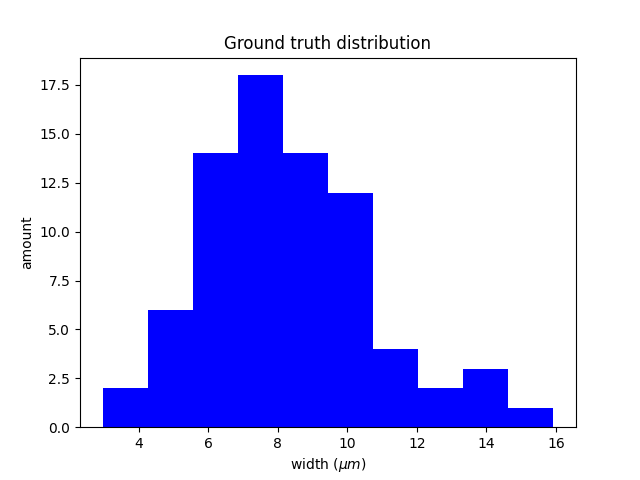

In [139]:
%matplotlib widget
width = np.array(list(width_dict.values()))*2
plt.hist(width,color="blue")
plt.title("Ground truth distribution")
plt.xlabel("width ($\mathit{\mu m}$)")
plt.ylabel("amount")
plt.show()

In [8]:
df = pd.read_excel(os.path.join(labelme_path,"Fluorescence_ex_Kai-kai_Plate521.xlsx"),engine = "openpyxl",sheet_name="PrinceData",index_col=0)
df

,Node,Node2
pos,,
pos1,403,575
pos2,575,721
pos3,721,814
pos4,814,1028
pos5,1028,1077
...,...,...
pos72,No,No
pos73,No,No
pos74,2507,2442


In [9]:
%matplotlib widget
f = lambda n: generate_index_along_sequence(n, resolution=4, offset=5)
f_profiles = lambda edge: extract_section_profiles_for_edge(
    exp, 0, edge, resolution=5, offset=5, step=1,target_length=120)

/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/experiment_util.py:232: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


pos71
pos72
pos73


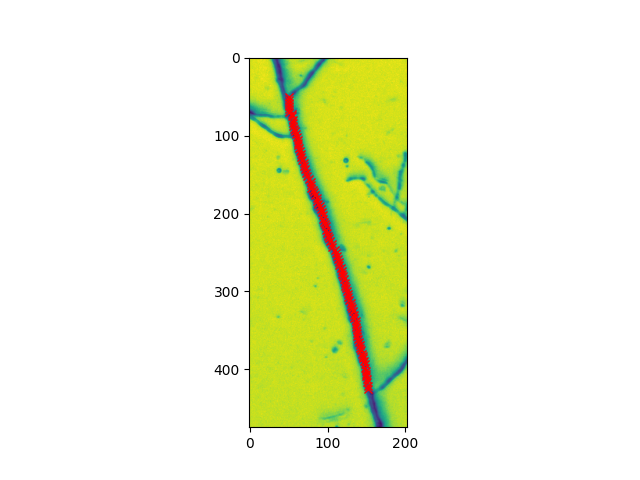

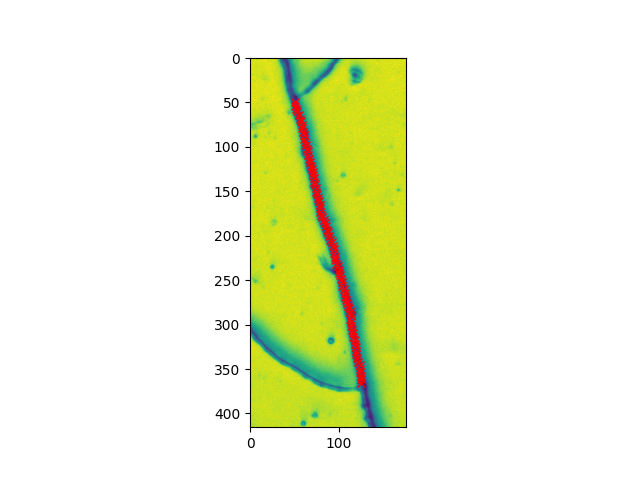

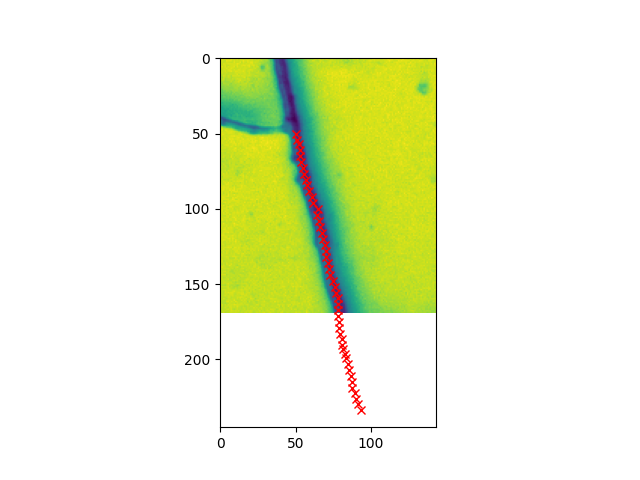

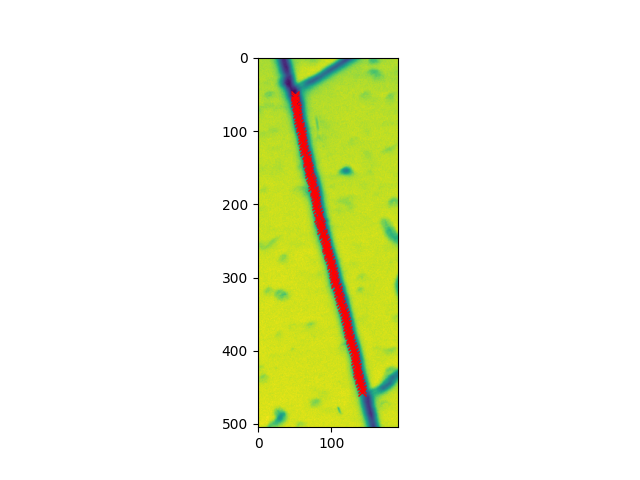

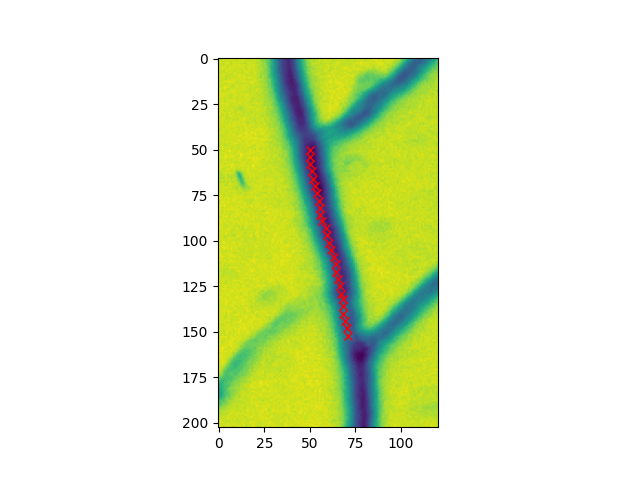

...

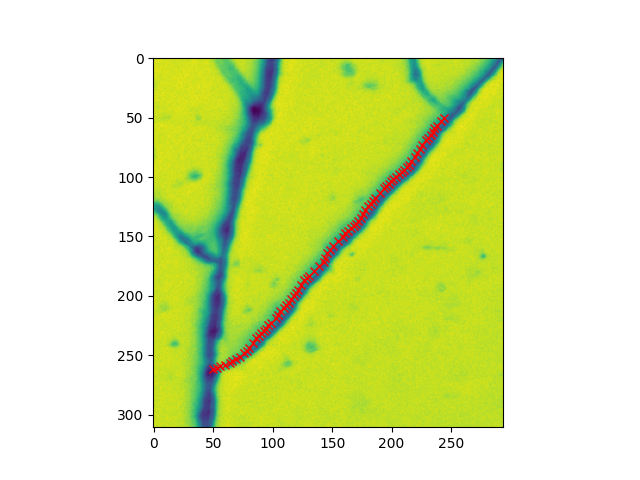

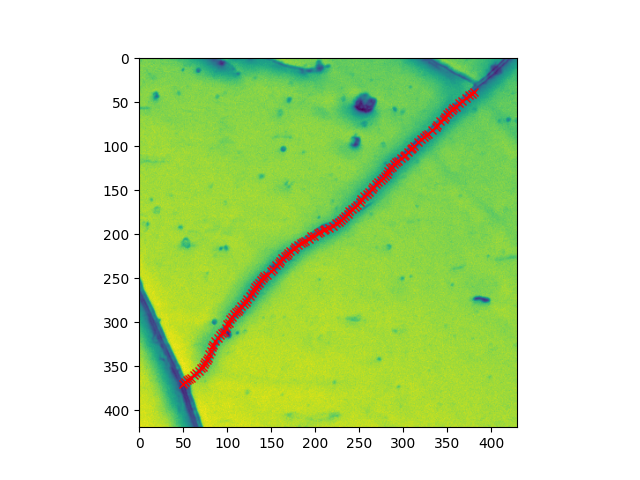

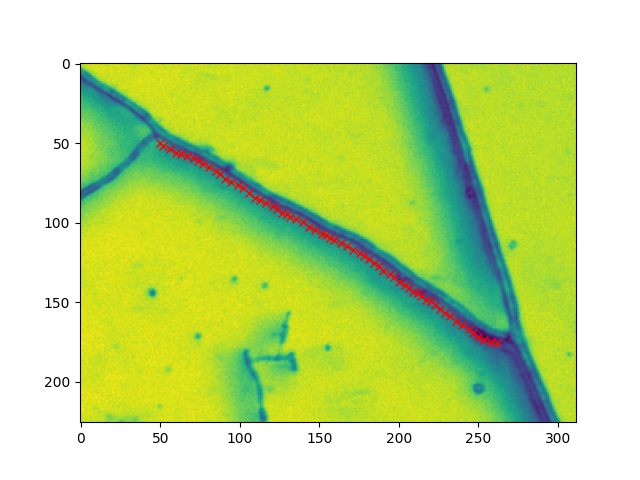

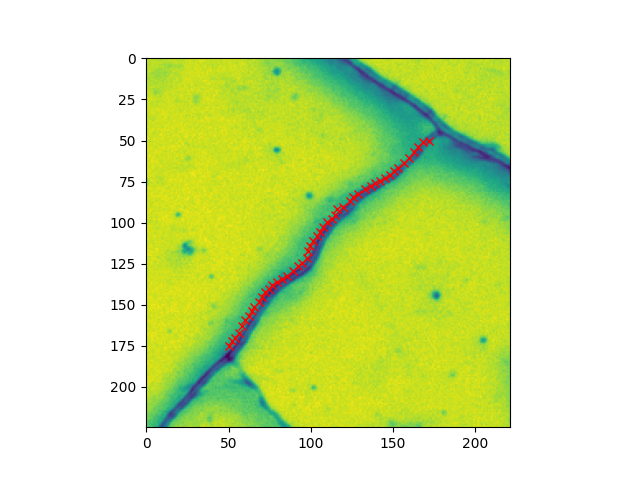

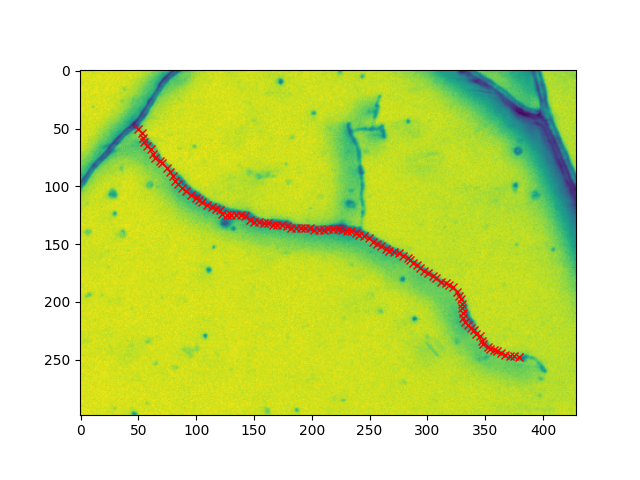

In [8]:
for index, row in df.iterrows():
    node,node2 = row["Node"] , row["Node2"]
    try:
        edge = get_edge_from_node_labels(exp, 0, node, node2)
        plot_edge_cropped(edge, 0, mode=3, f=f)
    except AttributeError:
        print(index)

In [10]:
%matplotlib widget
slices_dict = {}
for index, row in df.iterrows():
    node,node2 = row["Node"] , row["Node2"]
    try:
        edge = get_edge_from_node_labels(exp, 0, node, node2)
        slices, coords1, coords2 = f_profiles(edge)
        slices_dict[index] = slices
    except AttributeError:
        print(index)

pos71
pos72
pos73


In [12]:
slices_dict1 = slices_dict
slices_dict1["pos6"] = slices_dict1["pos6"][:len(slices)//4]
slices_dict1["pos7"] = slices_dict1["pos6"][len(slices)//2:]

In [ ]:
# pos6,pos7 is on the same segment.
# Need to distinguish it
%matplotlib widget
node,node2 = df.loc["pos6"].to_list()
edge = get_edge_from_node_labels(exp, 0, node, node2)
plot_edge_cropped(edge, 0, mode=3, f=f)

In [ ]:
%matplotlib widget
slices, coords1, coords2 = f_profiles(edge)
plt.imshow(slices[:50])

In [ ]:
%matplotlib widget
slices, coords1, coords2 = f_profiles(edge)
plt.imshow(slices[len(slices)//2:])

In [ ]:
collect_slice = []
collect_label = []
for key in slices_dict.keys():
    slices = slices_dict[key]
    if key == "pos6":
        slices = slices[:len(slices)//4]
    if key == "pos7":
        slices = slices[len(slices)//2:]
    for i in range(1,5):
        collect_slice.extend(slices[i*len(slices)//5 : i*len(slices)//5+1])
    collect_label.extend([width_dict[key]]*4)

In [ ]:
slice_array = np.array(collect_slice)
label_array = np.array(collect_label)
print(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")

In [ ]:
os.mkdir(os.path.join(dataset_path, "20230109_Plate521"))
cv2.imwrite(os.path.join(dataset_path, "20230109_Plate521","slices.png"), slice_array)
with open(os.path.join(dataset_path, "20230109_Plate521","labels.npy"), "wb") as f:
    np.save(f, label_array)
with open(os.path.join(dataset_path, "20230109_Plate521","info.txt"), "w") as f:
    f.write(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")
    f.write('\nPlate number 521\nStrain: C2\nCrossdate: 04/01/23\nPrince position: 2\nPRINCE FULL DATA: 20230109_1409_Plate02\nNotice: bin2. The width should be multiply by 2.')

In [ ]:
%matplotlib widget
X_test,y_test = data("20230109_Plate521")
y_test = y_test*2
print(X_test.shape,y_test.shape)
plt.hist(y_test,color="blue")
plt.title("Ground truth distribution Plate521 Jan 09")
plt.xlabel("width ($\mathit{\mu m}$)")
plt.ylabel("amount")
plt.show()

## Load model and check accuracy

In [ ]:
BO_without = load_model(model_path, select_model="bin2_BO_without_crop_best_model_val_version")
BO_100 = load_model(model_path, select_model="bin2_BO_crop_100_best_model_val_version")
BO_80 = load_model(model_path, select_model="bin2_BO_crop_80_best_model_val_version")
HB_without = load_model(model_path, select_model="bin2_HB_without_crop_best_model_val_version")
HB_100 = load_model(model_path, select_model="bin2_HB_crop_100_best_model_val_version")
HB_80 = load_model(model_path, select_model="bin2_HB_crop_80_best_model_val_version")
felix = keras.models.load_model("/home/ipausers/lin/Desktop/Graduation/AMFtrack/amftrack/ml/models/default_model")
HB_model = [HB_without,HB_100,HB_80]
BO_model = [BO_without,BO_100,BO_80]
HB_label = ["HB_without","HB_100","HB_80"]
BO_label = ["BO_without","BO_100","BO_80"]
data_preparation_value=[120,100,80]

In [ ]:
X_test,y_test = data("20230109_Plate521")
y_test = y_test*2
X_test.shape,y_test.shape

In [ ]:
HB_accuracy = []
for i in range(len(HB_model)):
    HB_accuracy.append([])
BO_accuracy = []
for i in range(len(BO_model)):
    BO_accuracy.append([])
felix_accuracy=[]

def data_preparation(X_test,size=OUTPUTSIZE):
    data_preprocessing = keras.Sequential([
        tf.keras.Input(shape=(IMAGESIZE, 1)),
        center_crop_layer(IMAGESIZE, size)])
    return data_preprocessing(X_test)

from sklearn.utils import resample
import matplotlib.pyplot as plt
n_iterations = 1000
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=50)
    i = 0
    loss, acc = HB_model[i].evaluate(X_bs,y_bs,verbose=1)
    HB_accuracy[i].append(acc)
    loss, acc = BO_model[i].evaluate(X_bs,y_bs,verbose=1)
    BO_accuracy[i].append(acc)
    for i in range(1,3):
        loss, acc = BO_model[i].evaluate(data_preparation(X_bs,size = data_preparation_value[i]),y_bs,verbose=1)
        BO_accuracy[i].append(acc)
        loss, acc = HB_model[i].evaluate(data_preparation(X_bs,size = data_preparation_value[i]),y_bs,verbose=1)
        HB_accuracy[i].append(acc)
    loss, acc = felix.evaluate(data_preparation(X_bs,100),y_bs,verbose=1)
    felix_accuracy.append(acc)

In [ ]:
import seaborn as sns
# Check MAE
# plot distribution of accuracy
%matplotlib widget
for i in range(len(BO_accuracy)):
    sns.kdeplot(BO_accuracy[i],label=BO_label[i])
for i in range(len(HB_accuracy)):
    sns.kdeplot(HB_accuracy[i],label=HB_label[i])
sns.kdeplot(felix_accuracy,label="felix model")
# plt.xlim(0,5)
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("MAE across 1000 bootstrap samples")
plt.xlabel("MAE")
plt.savefig("plot_data/compare_model/20230120 MAE HB vs BO in plate521.png", bbox_inches='tight')

In [ ]:
HB_accuracy_RE = []
for i in range(len(HB_model)):
    HB_accuracy_RE.append([])
BO_accuracy_RE = []
for i in range(len(BO_model)):
    BO_accuracy_RE.append([])
felix_accuracy_RE = []

In [ ]:
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=50)
    i = 0
    RE = np.mean(abs(HB_model[i].predict(X_bs)-y_bs)/y_bs)
    HB_accuracy_RE[i].append(RE)
    RE = np.mean(abs(BO_model[i].predict(X_bs)-y_bs)/y_bs)
    BO_accuracy_RE[i].append(RE)
    for i in range(1,3):
        RE = np.mean(abs(BO_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)/y_bs)
        BO_accuracy_RE[i].append(RE)
        RE = np.mean(abs(HB_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)/y_bs)
        HB_accuracy_RE[i].append(RE)
    RE = np.mean(abs(felix.predict(data_preparation(X_bs,100))-y_bs)/y_bs)
    felix_accuracy_RE.append(RE)

In [ ]:
# Check RE
%matplotlib widget
for i in range(len(BO_model)):
    sns.kdeplot(BO_accuracy_RE[i],label=BO_label[i])
for i in range(len(HB_model)):
    sns.kdeplot(HB_accuracy_RE[i],label=HB_label[i])
sns.kdeplot(felix_accuracy_RE,label="felix model")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("Relative Error across 1000 bootstrap samples")
plt.xlabel("Relative Error")
plt.savefig("plot_data/compare_model/20230120 RE HB vs BO in plate521.png", bbox_inches='tight')

In [ ]:
%matplotlib widget
fig = plt.figure(figsize=(30, 4))
total_model = len(HB_model)+len(BO_model)+1
i=0
compare_different_model(HB_model[i], X_test, y_test, x_range=[0,20], set_title=HB_label[i], total=total_model, plot_number=i+1)
compare_different_model(BO_model[i], X_test, y_test, x_range=[0,20], set_title=BO_label[i], total=total_model, plot_number=len(HB_model)+1)
for i in range(1,len(HB_model)):
    compare_different_model(HB_model[i], data_preparation(X_test,data_preparation_value[i]), y_test, x_range=[0,20], set_title=HB_label[i], total=total_model, plot_number=i+1)
for j in range(1,len(BO_model)):
    compare_different_model(BO_model[j], data_preparation(X_test,data_preparation_value[j]), y_test, x_range=[0,20], set_title=BO_label[j], total=total_model, plot_number=len(HB_model)+j+1)
compare_different_model(felix, data_preparation(X_test,100), y_test, x_range=[0,20], set_title="felix_model", total=total_model, plot_number=total_model)
plt.savefig("plot_data/compare_model/20230119 HB vs BO in plate521.png", bbox_inches='tight')

In [ ]:
%matplotlib widget
plt.plot(BO_100.predict(data_preparation(X_test,100)),y_test,"o")
plt.plot((1,18),(1,18))
plt.title("BO 100")
plt.ylabel("actual width ($\mathit{\mu m}$)")
plt.xlabel("predict width ($\mathit{\mu m}$)")
plt.savefig("plot_data/compare_model/20230120 BO_100 in plate521.png", bbox_inches='tight')

In [ ]:
%matplotlib widget
plt.plot(HB_80.predict(data_preparation(X_test,80)),y_test,"o")
plt.plot((1,18),(1,18))
plt.title("HB 80")
plt.xlabel("predict width ($\mathit{\mu m}$)")
plt.ylabel("actual width ($\mathit{\mu m}$)")
plt.savefig("plot_data/compare_model/20230120 HB_80 in plate521.png", bbox_inches='tight')

In [ ]:
HB_accuracy_ME = []
for i in range(len(HB_model)):
    HB_accuracy_ME.append([])
BO_accuracy_ME = []
for i in range(len(BO_model)):
    BO_accuracy_ME.append([])
felix_accuracy_ME = []

In [ ]:
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=50)
    i = 0
    ME = np.mean(HB_model[i].predict(X_bs)-y_bs)
    HB_accuracy_ME[i].append(ME)
    ME = np.mean(BO_model[i].predict(X_bs)-y_bs)
    BO_accuracy_ME[i].append(ME)
    for i in range(1,3):
        ME = np.mean(BO_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)
        BO_accuracy_ME[i].append(ME)
        ME = np.mean(HB_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)
        HB_accuracy_ME[i].append(ME)
    ME = np.mean(felix.predict(data_preparation(X_bs,100))-y_bs)
    felix_accuracy_ME.append(ME)

In [ ]:
# Check ME
%matplotlib widget
for i in range(len(BO_model)):
    sns.kdeplot(BO_accuracy_ME[i],label=BO_label[i])
for i in range(len(HB_model)):
    sns.kdeplot(HB_accuracy_ME[i],label=HB_label[i])
sns.kdeplot(felix_accuracy_ME,label="felix model")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("Mean Error across 1000 bootstrap samples")
plt.axvline(0,linestyle="--")
plt.xlabel("Mean Error")
plt.savefig("plot_data/compare_model/20230120 ME HB vs BO in plate521.png", bbox_inches='tight')

# Check plate 521 - day2

## create dataset

In [13]:
directory_groundtruths = os.path.join(storage_path)
directory = directory_groundtruths+"/old/"
update_plate_info(directory)
folder_df = get_current_folders(directory)
select = folder_df[(folder_df["Plate"] == "521") & (folder_df["folder"] =="20230111_1349_Plate02")]
select

analysed:   0%|          | 0/3 [00:00<?, ?it/s]

,total_path,Plate,PrincePos,root,strain,medium,split,Pbait,CrossDate,Temperature,...,/Analysis/transform.mat,/Analysis/transform_corrupt.mat,/Analysis/skeleton_realigned_compressed.mat,/Analysis/nx_graph_pruned.p,/Analysis/nx_graph_pruned_width.p,/Analysis/nx_graph_pruned_labeled.p,date,folder,unique_id,datetime
0,/home/ipausers/lin/Desktop/data//old/20230111_...,521,2,'Carrot','C2','001P100N100C','Y','-',20230104,25,...,True,False,True,True,True,True,"11.01.2023, 13:49:",20230111_1349_Plate02,521_20230104,2023-01-11 13:49:00


In [ ]:
%matplotlib widget
exp = Experiment(directory)
exp.load(select, suffix="")
exp.load_tile_information(0)
plot_full_image_with_features(exp, 0, 
                              downsizing=10,
                              dilation=1,
                              edges=get_all_edges(exp, 0),
                              nodes=get_all_nodes(exp, 0))

/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/experiment_class_surf.py:103: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.folders["datetime"] = pd.to_datetime(


2023-01-11 13:49:00


In [ ]:
import networkx as nx
t = 0
G, pos = exp.nx_graph[t], exp.positions[t]
nodes = []
node_label=[]
for path in sorted(nx.shortest_path(G, 4547, 3052)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1132, 1089)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1094, 1075)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1102, 1139)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1964, 3052)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 5707, 4543)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 3513, 2723)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 2504, 3024)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 2504, 1819)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1102, 1819)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1102, 1141)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1499, 852)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 3513, 5592)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G,4547, 4430)):
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G,3052, 3160)):
    node_label.append(path)
    nodes.append(Node(path,exp))
    
for path in sorted(nx.shortest_path(G,4430, 3160)):
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G,3372, 3160)):
    node_label.append(path)
    nodes.append(Node(path,exp))
%matplotlib widget
plot_full_image_with_features(
    exp,
    t=0,
    downsizing=10,
    nodes = nodes,
)

In [18]:
segment = get_labelme_segments(os.path.join(labelme_path,"20230104_Plate521_2/"))
width_dict,width_std_dict= compute_width_from_segment(segment)

In [ ]:
%matplotlib widget
width = np.array(list(width_dict.values()))*2
plt.hist(width,color="blue")
plt.title("Ground truth distribution")
plt.xlabel("width ($\mathit{\mu m}$)")
plt.ylabel("amount")
plt.show()

In [14]:
df = pd.read_excel(os.path.join(labelme_path,"Fluorescence_ex_Kai-kai_Plate521.xlsx"),engine = "openpyxl",sheet_name="PrinceData0111",index_col=0)

In [20]:
%matplotlib widget
df = pd.read_excel(os.path.join(labelme_path,"Fluorescence_ex_Kai-kai_Plate521.xlsx"),engine = "openpyxl",sheet_name="PrinceData0111",index_col=0)
f = lambda n: generate_index_along_sequence(n, resolution=4, offset=5)
f_profiles = lambda edge: extract_section_profiles_for_edge(
    exp, 0, edge, resolution=5, offset=5, step=1,target_length=120)
for index, row in df.iterrows():
    node,node2 = row["Node"] , row["Node2"]
    try:
        edge = get_edge_from_node_labels(exp, 0, node, node2)
        plot_edge_cropped(edge, 0, mode=3, f=f)
    except AttributeError:
        print(index)

In [ ]:
%matplotlib widget
slices, coords1, coords2 = f_profiles(edge)
plt.imshow(slices[:])

In [ ]:
# pos6,pos7 are on the same segment.
# pos9 - 13 are on the same segment.
# Need to distinguish it
%matplotlib widget
node,node2 = df.loc["pos9"].to_list()
edge = get_edge_from_node_labels(exp, 0, node, node2)
plot_edge_cropped(edge, 0, mode=3, f=f)
edge

In [15]:
%matplotlib widget
slices_dict = {}
for index, row in df.iterrows():
    node,node2 = row["Node"] , row["Node2"]
    try:
        edge = get_edge_from_node_labels(exp, 0, node, node2)
        slices, coords1, coords2 = f_profiles(edge)
        slices_dict[index] = slices
    except AttributeError:
        print(index)

In [ ]:
collect_slice = []
collect_label = []
for key in slices_dict.keys():
    slices = slices_dict[key]
    # pos9 - 13 are on the same segment.
    if key == "pos9":
        slices = slices[340:380]
    if key == "pos10":
        slices = slices[235:290]
    if key == "pos11":
        slices = slices[180:230]
    if key == "pos12":
        slices = slices[125:170]
    if key == "pos13":
        slices = slices[:70]
        
    # pos6,pos7 are on the same segment.
    if key == "pos6":
        slices = slices[160:]
    if key == "pos7":
        slices = slices[:120]
    for i in range(1,5):
        collect_slice.extend(slices[i*len(slices)//5 : i*len(slices)//5+1])
    collect_label.extend([width_dict[key]]*4)

In [16]:
slices_dict2 = slices_dict

In [ ]:
slice_array = np.array(collect_slice)
label_array = np.array(collect_label)
print(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")

In [ ]:
os.mkdir(os.path.join(dataset_path, "20230111_Plate521"))
cv2.imwrite(os.path.join(dataset_path, "20230111_Plate521","slices.png"), slice_array)
with open(os.path.join(dataset_path, "20230111_Plate521","labels.npy"), "wb") as f:
    np.save(f, label_array)
with open(os.path.join(dataset_path, "20230111_Plate521","info.txt"), "w") as f:
    f.write(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")
    f.write('\nPlate number 521\nStrain: C2\nCrossdate: 04/01/23\nPrince position: 2\nPRINCE FULL DATA: 20230111_1349_Plate02\nNotice: bin2. The width should be multiply by 2.')

In [ ]:
%matplotlib widget
X_test,y_test = data("20230111_Plate521")
y_test = y_test*2
print(X_test.shape,y_test.shape)
plt.hist(y_test,color="blue")
plt.title("Ground truth distribution Plate521 Jan 11")
plt.xlabel("width ($\mathit{\mu m}$)")
plt.ylabel("amount")
plt.show()

## Load model and check accuracy

In [ ]:
BO_without = load_model(model_path, select_model="bin2_BO_without_crop_best_model_val_version")
BO_100 = load_model(model_path, select_model="bin2_BO_crop_100_best_model_val_version")
BO_80 = load_model(model_path, select_model="bin2_BO_crop_80_best_model_val_version")
HB_without = load_model(model_path, select_model="bin2_HB_without_crop_best_model_val_version")
HB_100 = load_model(model_path, select_model="bin2_HB_crop_100_best_model_val_version")
HB_80 = load_model(model_path, select_model="bin2_HB_crop_80_best_model_val_version")
felix = keras.models.load_model("/home/ipausers/lin/Desktop/Graduation/AMFtrack/amftrack/ml/models/default_model")
HB_model = [HB_without,HB_100,HB_80]
BO_model = [BO_without,BO_100,BO_80]
HB_label = ["HB_without","HB_100","HB_80"]
BO_label = ["BO_without","BO_100","BO_80"]
data_preparation_value=[120,100,80]

In [ ]:
X_test,y_test = data("20230111_Plate521")
y_test = y_test*2
X_test.shape,y_test.shape

In [ ]:
HB_accuracy = []
for i in range(len(HB_model)):
    HB_accuracy.append([])
BO_accuracy = []
for i in range(len(BO_model)):
    BO_accuracy.append([])
felix_accuracy=[]

def data_preparation(X_test,size=OUTPUTSIZE):
    data_preprocessing = keras.Sequential([
        tf.keras.Input(shape=(IMAGESIZE, 1)),
        center_crop_layer(IMAGESIZE, size)])
    return data_preprocessing(X_test)

from sklearn.utils import resample
import matplotlib.pyplot as plt
n_iterations = 1000
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=50)
    i = 0
    loss, acc = HB_model[i].evaluate(X_bs,y_bs,verbose=1)
    HB_accuracy[i].append(acc)
    loss, acc = BO_model[i].evaluate(X_bs,y_bs,verbose=1)
    BO_accuracy[i].append(acc)
    for i in range(1,3):
        loss, acc = BO_model[i].evaluate(data_preparation(X_bs,size = data_preparation_value[i]),y_bs,verbose=1)
        BO_accuracy[i].append(acc)
        loss, acc = HB_model[i].evaluate(data_preparation(X_bs,size = data_preparation_value[i]),y_bs,verbose=1)
        HB_accuracy[i].append(acc)
    loss, acc = felix.evaluate(data_preparation(X_bs,100),y_bs,verbose=1)
    felix_accuracy.append(acc)

In [ ]:
import seaborn as sns
# Check MAE
# plot distribution of accuracy
%matplotlib widget
for i in range(len(BO_accuracy)):
    sns.kdeplot(BO_accuracy[i],label=BO_label[i])
for i in range(len(HB_accuracy)):
    sns.kdeplot(HB_accuracy[i],label=HB_label[i])
sns.kdeplot(felix_accuracy,label="felix model")
plt.title("MAE across 1000 bootstrap samples")
plt.xlabel("MAE")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.savefig("plot_data/compare_model/20230125 MAE HB vs BO in plate521_day2.png", bbox_inches='tight')

In [ ]:
HB_accuracy_RE = []
for i in range(len(HB_model)):
    HB_accuracy_RE.append([])
BO_accuracy_RE = []
for i in range(len(BO_model)):
    BO_accuracy_RE.append([])
felix_accuracy_RE = []

In [ ]:
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=10)
    i = 0
    RE = np.mean(abs(HB_model[i].predict(X_bs,verbose=0)-y_bs)/y_bs)
    if RE > 1e5:
        print(abs(HB_model[i].predict(X_bs,verbose=0)-y_bs))
    HB_accuracy_RE[i].append(RE)
    RE = np.mean(abs(BO_model[i].predict(X_bs,verbose=0)-y_bs)/y_bs)
    if RE > 1e5:
        print(abs(BO_model[i].predict(X_bs,verbose=0)-y_bs))
    BO_accuracy_RE[i].append(RE)
    for i in range(1,3):
        RE = np.mean(abs(BO_model[i].predict(data_preparation(X_bs,data_preparation_value[i]),verbose=0)-y_bs)/y_bs)
        if RE > 1e5:
            print(abs(BO_model[i].predict(data_preparation(X_bs,data_preparation_value[i]),verbose=0)-y_bs))
        BO_accuracy_RE[i].append(RE)
        RE = np.mean(abs(HB_model[i].predict(data_preparation(X_bs,data_preparation_value[i]),verbose=0)-y_bs)/y_bs)
        if RE > 1e5:
            print(abs(HB_model[i].predict(data_preparation(X_bs,data_preparation_value[i]),verbose=0)-y_bs))
        HB_accuracy_RE[i].append(RE)
    RE = np.mean(abs(felix.predict(data_preparation(X_bs,100),verbose=0)-y_bs)/y_bs)
    felix_accuracy_RE.append(RE)

In [ ]:
# Check RE
%matplotlib widget
for i in range(len(BO_model)):
    sns.kdeplot(BO_accuracy_RE[i],label=BO_label[i])
for i in range(len(HB_model)):
    sns.kdeplot(HB_accuracy_RE[i],label=HB_label[i])
sns.kdeplot(felix_accuracy_RE,label="felix model")
plt.title("Relative Error across 1000 bootstrap samples")
plt.xlabel("Relative Error")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.savefig("plot_data/compare_model/20230125 RE HB vs BO in plate521_day2.png", bbox_inches='tight')

In [ ]:
%matplotlib widget
fig = plt.figure(figsize=(30, 4))
total_model = len(HB_model)+len(BO_model)+1
i=0
compare_different_model(HB_model[i], X_test, y_test, x_range=[0,20], set_title=HB_label[i], total=total_model, plot_number=i+1)
compare_different_model(BO_model[i], X_test, y_test, x_range=[0,20], set_title=BO_label[i], total=total_model, plot_number=len(HB_model)+1)
for i in range(1,len(HB_model)):
    compare_different_model(HB_model[i], data_preparation(X_test,data_preparation_value[i]), y_test, x_range=[0,20], set_title=HB_label[i], total=total_model, plot_number=i+1)
for j in range(1,len(BO_model)):
    compare_different_model(BO_model[j], data_preparation(X_test,data_preparation_value[j]), y_test, x_range=[0,20], set_title=BO_label[j], total=total_model, plot_number=len(HB_model)+j+1)
compare_different_model(felix, data_preparation(X_test,100), y_test, x_range=[0,20], set_title="felix_model", total=total_model, plot_number=total_model)
plt.savefig("plot_data/compare_model/20230125 HB vs BO in plate521_day2.png", bbox_inches='tight')

In [ ]:
%matplotlib widget
plt.plot(BO_100.predict(data_preparation(X_test,100)),y_test,"o")
plt.plot((1,18),(1,18))
plt.title("BO 100")
plt.ylabel("actual width ($\mathit{\mu m}$)")
plt.xlabel("predict width ($\mathit{\mu m}$)")
plt.savefig("plot_data/compare_model/20230125 BO_100 in plate521_day2.png", bbox_inches='tight')

In [ ]:
%matplotlib widget
plt.plot(HB_80.predict(data_preparation(X_test,80)),y_test,"o")
plt.plot((1,18),(1,18))
plt.title("HB 80")
plt.xlabel("predict width ($\mathit{\mu m}$)")
plt.ylabel("actual width ($\mathit{\mu m}$)")
plt.savefig("plot_data/compare_model/20230125 HB_80 in plate521_day2.png", bbox_inches='tight')

In [ ]:
HB_accuracy_ME = []
for i in range(len(HB_model)):
    HB_accuracy_ME.append([])
BO_accuracy_ME = []
for i in range(len(BO_model)):
    BO_accuracy_ME.append([])
felix_accuracy_ME = []

In [ ]:
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=50)
    i = 0
    ME = np.mean(HB_model[i].predict(X_bs)-y_bs)
    HB_accuracy_ME[i].append(ME)
    ME = np.mean(BO_model[i].predict(X_bs)-y_bs)
    BO_accuracy_ME[i].append(ME)
    for i in range(1,3):
        ME = np.mean(BO_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)
        BO_accuracy_ME[i].append(ME)
        ME = np.mean(HB_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)
        HB_accuracy_ME[i].append(ME)
    ME = np.mean(felix.predict(data_preparation(X_bs,100))-y_bs)
    felix_accuracy_ME.append(ME)

In [ ]:
# Check ME
%matplotlib widget
for i in range(len(BO_model)):
    sns.kdeplot(BO_accuracy_ME[i],label=BO_label[i])
for i in range(len(HB_model)):
    sns.kdeplot(HB_accuracy_ME[i],label=HB_label[i])
sns.kdeplot(felix_accuracy_ME,label="felix model")

plt.title("Mean Error across 1000 bootstrap samples")
plt.axvline(0,linestyle="--")
plt.xlabel("Mean Error")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.savefig("plot_data/compare_model/20230125 ME HB vs BO in plate521_day2.png", bbox_inches='tight')

# Check plate 521 - day3

## create dataset

In [17]:
directory_groundtruths = os.path.join(storage_path)
directory = directory_groundtruths+"/old/"
update_plate_info(directory)
folder_df = get_current_folders(directory)
select = folder_df[(folder_df["Plate"] == "521") & (folder_df["folder"] =="20230113_0949_Plate02_re")]
select

analysed:   0%|          | 0/3 [00:00<?, ?it/s]

,total_path,Plate,PrincePos,root,strain,medium,split,Pbait,CrossDate,Temperature,...,/Analysis/transform.mat,/Analysis/transform_corrupt.mat,/Analysis/skeleton_realigned_compressed.mat,/Analysis/nx_graph_pruned.p,/Analysis/nx_graph_pruned_width.p,/Analysis/nx_graph_pruned_labeled.p,date,folder,unique_id,datetime
2,/home/ipausers/lin/Desktop/data//old/20230113_...,521,2,'Carrot','C2','001P100N100C','Y','-',20230104,25,...,True,False,True,True,True,True,"13.01.2023, 09:49:",20230113_0949_Plate02_re,521_20230104,2023-01-13 09:49:00


In [18]:
%matplotlib widget
exp = Experiment(directory)
exp.load(select, suffix="")
exp.load_tile_information(0)
plot_full_image_with_features(exp, 0, 
                              downsizing=10,
                              dilation=1,
                              edges=get_all_edges(exp, 0),
                              nodes=get_all_nodes(exp, 0))

/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/experiment_class_surf.py:103: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.folders["datetime"] = pd.to_datetime(


2023-01-13 09:49:00


In [ ]:
import networkx as nx
t = 0
G, pos = exp.nx_graph[t], exp.positions[t]
nodes = []
node_label=[]
for path in sorted(nx.shortest_path(G, 1908, 6463)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 1182, 6364)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 621, 6364)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 4211, 3903)): 
    node_label.append(path)
    nodes.append(Node(path,exp))   
for path in sorted(nx.shortest_path(G, 3522, 3903)): 
    node_label.append(path)
    nodes.append(Node(path,exp))  
for path in sorted(nx.shortest_path(G, 3563, 3903)): 
    node_label.append(path)
    nodes.append(Node(path,exp)) 
for path in sorted(nx.shortest_path(G, 3574, 2893)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 2379, 3044)): 
    node_label.append(path)
    nodes.append(Node(path,exp))  
for path in sorted(nx.shortest_path(G, 1685, 1545)): 
    node_label.append(path)
    nodes.append(Node(path,exp))  
for path in sorted(nx.shortest_path(G, 5544, 4908)): 
    node_label.append(path)
    nodes.append(Node(path,exp))  
for path in sorted(nx.shortest_path(G, 4908, 4230)): 
    node_label.append(path)
    nodes.append(Node(path,exp)) 
for path in sorted(nx.shortest_path(G, 3821, 4052)): 
    node_label.append(path)
    nodes.append(Node(path,exp))    
    
%matplotlib widget
plot_full_image_with_features(
    exp,
    t=0,
    downsizing=10,
    nodes = nodes,
)

In [27]:
segment = get_labelme_segments(os.path.join(labelme_path,"20230104_Plate521_3/"))
width_dict,width_std_dict= compute_width_from_segment(segment)

In [ ]:
%matplotlib widget
width = np.array(list(width_dict.values()))*2
plt.hist(width,color="blue")
plt.title("Ground truth distribution")
plt.xlabel("width ($\mathit{\mu m}$)")
plt.ylabel("amount")
plt.show()

In [28]:
df = pd.read_excel(os.path.join(labelme_path,"Fluorescence_ex_Kai-kai_Plate521.xlsx"),engine = "openpyxl",sheet_name="PrinceData0113",index_col=0)

In [ ]:
%matplotlib widget
get_slices_dict(df,exp,target_length=120,output_type="check")

In [31]:
slices_dict3,edge = get_slices_dict(df,exp,target_length=120,output_type="data")

pos15  will not be processed!


In [ ]:
# pos6-7, pos10-13, pos37-38 are on the same segment.
# Need to distinguish it
%matplotlib widget
slices,edge = get_slices_dict(df[df.index == "pos37"],exp,target_length=120,output_type="data")
get_slices_dict(df[df.index == "pos37"],exp,target_length=120,output_type="check")

In [ ]:
%matplotlib widget
plt.imshow(slices.get("pos37"))

In [ ]:
collect_slice = []
collect_label = []
for key in slices_dict.keys():
    slices = slices_dict[key]
    # pos37 - 38 are on the same segment.
    if key == "pos37":
        slices = slices[115:135]
    if key == "pos38":
        slices = slices[:100]
    # pos10 - 13 are on the same segment.
    if key == "pos10":
        slices = slices[50:80]
    if key == "pos11":
        slices = slices[100:145]
    if key == "pos12":
        slices = slices[160:200]
    if key == "pos13":
        slices = slices[270:]
    # pos6,pos7 are on the same segment.
    if key == "pos6":
        slices = slices[160:]
    if key == "pos7":
        slices = slices[:120]
    for i in range(1,5):
        collect_slice.extend(slices[i*len(slices)//5 : i*len(slices)//5+1])
    collect_label.extend([width_dict[key]]*4)

In [ ]:
slice_array = np.array(collect_slice)
label_array = np.array(collect_label)
print(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")

In [ ]:
make_dataset(dataset_path,"20230113_Plate521",slice_array,label_array,"521","C2","04/01/23","2","2")

## Load model and check accuracy

In [2]:
X_test,y_test = data("20230113_Plate521")
y_test = y_test*2
X_test.shape,y_test.shape

((196, 120), (196, 1))

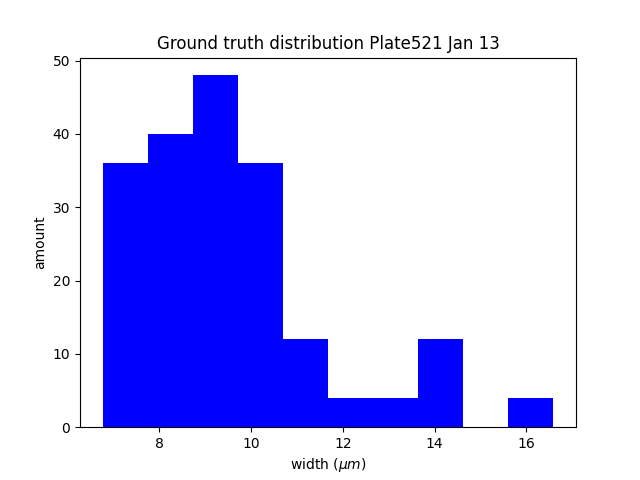

In [44]:
%matplotlib widget
plt.hist(y_test,color="blue")
plt.title("Ground truth distribution Plate521 Jan 13")
plt.xlabel("width ($\mathit{\mu m}$)")
plt.ylabel("amount")
plt.show()

In [4]:
model_name_list = ["bin2_BO_without_crop_best_model_val_version","bin2_BO_crop_100_best_model_val_version","bin2_BO_crop_80_best_model_val_version",
 "bin2_HB_without_crop_best_model_val_version","bin2_HB_crop_100_best_model_val_version","bin2_HB_crop_80_best_model_val_version",
 "default_model"]
crop_value = [120,100,80,120,100,80,100]
model_list,learning_rate = load_model_list(model_path,model_name_list)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 120, 1)            0         
                                                                 
 conv_1 (Conv1D)             (None, 101, 128)          2688      
                                                                 
 conv_2 (Conv1D)             (None, 91, 128)           180352    
                                                                 
 batch_normalization (BatchN  (None, 91, 128)          512       
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 91, 128)           0         
                                                                 
 flatten (Flatten)           (None, 11648)             0         
                                                        

In [30]:
MAE = statistic_evaluate(model_list,X_test,y_test,crop_value,statistic_type="MAE",n_iterations=1000,n_samples=10)

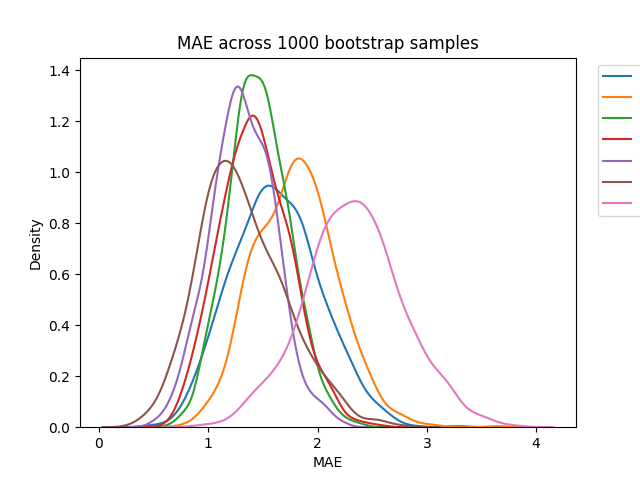

In [40]:
import seaborn as sns
%matplotlib widget
for i in range(len(model_name_list)):
    sns.kdeplot(MAE[i],label=model_name_list[i])
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("MAE across 1000 bootstrap samples")
plt.xlabel("MAE")
plt.savefig("plot_data/compare_model/20230201 MAE HB vs BO in plate521_day3.png", bbox_inches='tight')

In [32]:
RE = statistic_evaluate(model_list,X_test,y_test,crop_value,statistic_type="RE",n_iterations=1000,n_samples=10)

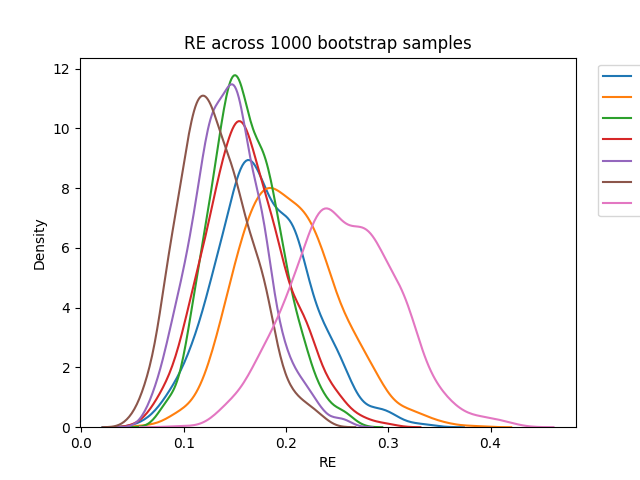

In [41]:
import seaborn as sns
%matplotlib widget
for i in range(len(model_name_list)):
    sns.kdeplot(RE[i],label=model_name_list[i])
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("RE across 1000 bootstrap samples")
plt.xlabel("RE")
plt.savefig("plot_data/compare_model/20230201 RE HB vs BO in plate521_day3.png", bbox_inches='tight')

In [34]:
ME = statistic_evaluate(model_list,X_test,y_test,crop_value,statistic_type="ME",n_iterations=1000,n_samples=10)

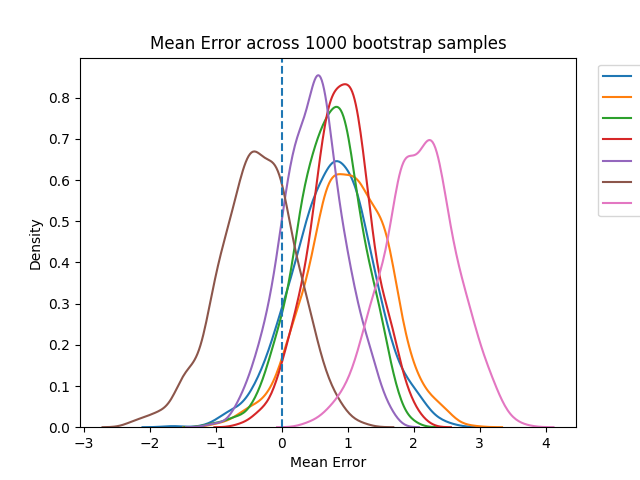

In [42]:
%matplotlib widget
for i in range(len(model_name_list)):
    sns.kdeplot(ME[i],label=model_name_list[i])
plt.title("Mean Error across 1000 bootstrap samples")
plt.axvline(0,linestyle="--")
plt.xlabel("Mean Error")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.savefig("plot_data/compare_model/20230201 ME HB vs BO in plate521_day3.png", bbox_inches='tight')

In [34]:
slices_dict1,slices_dict2,slices_dict3

({'pos1': array([[185., 184., 182., ..., 174., 169., 167.],
         [183., 182., 179., ..., 184., 182., 183.],
         [186., 187., 187., ..., 140., 135., 131.],
         ...,
         [181., 179., 178., ..., 183., 180., 181.],
         [179., 179., 177., ..., 154., 156., 156.],
         [177., 176., 175., ..., 173., 176., 175.]]),
  'pos2': array([[175., 172., 171., ...,  93.,  98., 102.],
         [172., 174., 175., ...,  91.,  88.,  85.],
         [175., 173., 172., ..., 173., 171., 173.],
         ...,
         [179., 179., 179., ..., 180., 180., 180.],
         [180., 181., 183., ..., 156., 161., 157.],
         [179., 178., 177., ..., 180., 182., 181.]]),
  'pos3': array([[178., 177., 176., ..., 150., 154., 155.],
         [176., 174., 174., ..., 168., 170., 173.],
         [176., 175., 177., ..., 178., 178., 174.],
         ...,
         [176., 175., 174., ..., 183., 184., 182.],
         [183., 181., 180., ..., 187., 185., 182.],
         [183., 176., 177., ..., 112., 111., 1

## Compare ground truth and predict width

In [36]:
latest = load_model(model_path,"BO_without_crop_best_model")

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 120, 1)            0         
                                                                 
 conv_1 (Conv1D)             (None, 101, 128)          2688      
                                                                 
 conv_2 (Conv1D)             (None, 91, 128)           180352    
                                                                 
 batch_normalization (BatchN  (None, 91, 128)          512       
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 91, 128)           0         
                                                                 
 flatten (Flatten)           (None, 11648)             0         
                                                        

In [ ]:
directory_groundtruths = os.path.join(storage_path,'old')
directory = directory_groundtruths+"/"
update_plate_info(directory)


In [115]:
dif1,dif2,dif3 = {},{},{}
for key,value in slices_dict2.items():
    try:
        exp1 = np.median(latest.predict(slices_dict1[key],verbose=0))
        exp2 = np.median(latest.predict(slices_dict2[key],verbose=0))
        exp3 = np.median(latest.predict(slices_dict3[key],verbose=0))
        dif1[key] = exp2-exp1
        dif2[key] = exp3-exp2
        dif3[key] = exp3-exp1
    except KeyError:
        print(key)

pos15


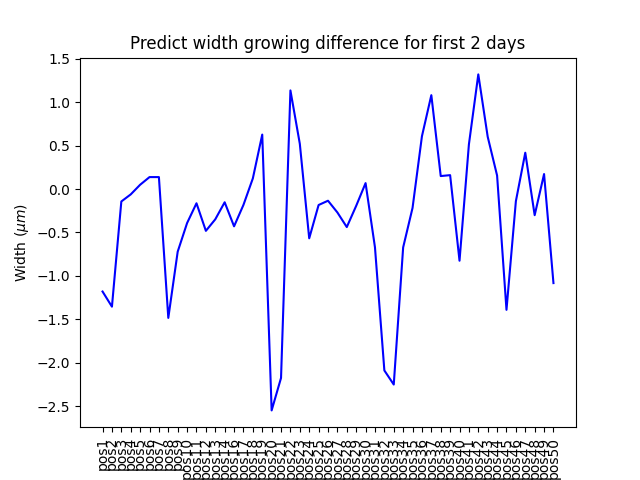

In [118]:
%matplotlib widget
hyphae1p = []
label1p = []
for key, value in dif1.items():
    hyphae1p.append(value)
    label1p.append(key)
plt.plot(hyphae1p,color="blue")
plt.xticks(np.arange(0,len(label1p),1),labels=label1p,rotation = 90)
plt.title("Predict width growing difference for first 2 days")
plt.xlabel("Position")
plt.ylabel("Width ($\mathit{\mu m}$)")
plt.savefig("plot_data/width growing/20230104_Plate521_11-9(Predict).png")

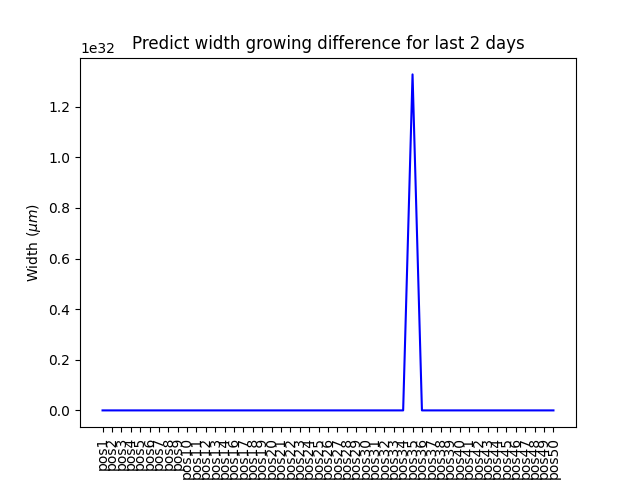

In [119]:
%matplotlib widget
hyphae2p = []
label2p = []
for key, value in dif2.items():
    hyphae2p.append(value)
    label2p.append(key)
plt.plot(hyphae2p,color="blue")
plt.xticks(np.arange(0,len(label2p),1),labels=label2p,rotation = 90)
plt.title("Predict width growing difference for last 2 days")
plt.xlabel("Position")
plt.ylabel("Width ($\mathit{\mu m}$)")
plt.savefig("plot_data/width growing/20230104_Plate521_13-11(Predict).png")

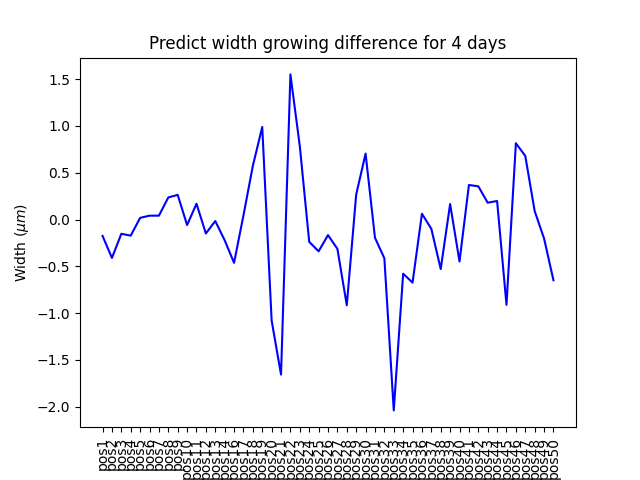

In [88]:
%matplotlib widget
hyphae3p = []
label3p = []
for key, value in dif3.items():
    hyphae3p.append(value)
    label3p.append(key)
plt.plot(hyphae3p,color="blue")
plt.xticks(np.arange(0,len(label3p),1),labels=label3p,rotation = 90)
plt.title("Predict width growing difference for 4 days")
plt.xlabel("Position")
plt.ylabel("Width ($\mathit{\mu m}$)")
plt.savefig("plot_data/width growing/20230104_Plate521_13-9(Predict).png")

In [105]:
segment = get_labelme_segments("/home/ipausers/lin/Desktop/Kai/Graduation-Project/Experiment/Labelme/20230104_Plate521")
width_dict,width_std_dict= compute_width_from_segment(segment)
segment2 = get_labelme_segments("/home/ipausers/lin/Desktop/Kai/Graduation-Project/Experiment/Labelme/20230104_Plate521_2")
width_dict2,width_std_dict2= compute_width_from_segment(segment2)
segment3 = get_labelme_segments("/home/ipausers/lin/Desktop/Kai/Graduation-Project/Experiment/Labelme/20230104_Plate521_3")
width_dict3,width_std_dict3= compute_width_from_segment(segment3)
dif1_g = {}
for key in width_dict2.keys():
    exp1 = width_dict[key]*2
    exp2 = width_dict2[key]*2
    dif1_g[key] = exp2-exp1
hyphae1g = []
label1g = []
for i in range(len(dif1_g)+1):
    for key, value in dif1_g.items():
        if i == int(key[3:]):
            hyphae1g.append(value)
            label1g.append(key)
dif2_g = {}
for key in width_dict3.keys():
    exp1 = width_dict2[key] * 2
    exp2 = width_dict3[key] * 2
    dif2_g[key] = exp2-exp1
hyphae2g = []
label2g = []
for i in range(len(dif2_g)+1):
    for key, value in dif2_g.items():
        if i == int(key[3:]):
            hyphae2g.append(value)
            label2g.append(key)
dif3_g = {}
for key in width_dict3.keys():
    exp1 = width_dict[key] * 2
    exp2 = width_dict3[key] * 2
    dif3_g[key] = exp2-exp1
hyphae3g = []
label3g = []
for i in range(len(dif3_g)+1):
    for key, value in dif3_g.items():
        if i == int(key[3:]):
            hyphae3g.append(value)
            label3g.append(key)

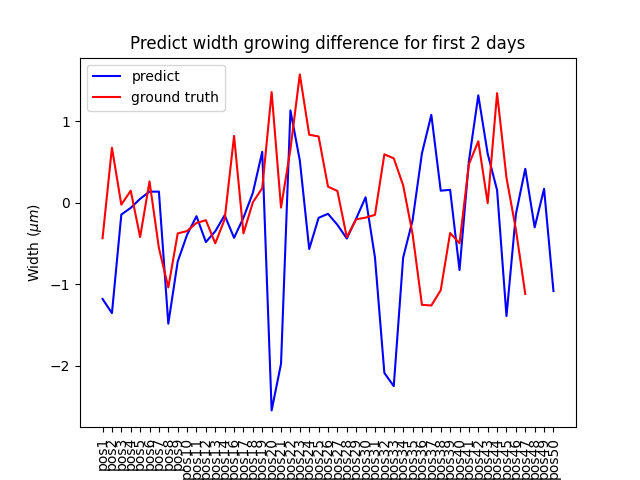

In [112]:
%matplotlib widget
plt.plot(hyphae1p,color="blue",label="predict")
del hyphae1g[14]
plt.plot(hyphae1g,color="red",label="ground truth")
plt.xticks(np.arange(0,len(label1p),1),labels=label1p,rotation = 90)
plt.title("Predict width growing difference for first 2 days")
plt.xlabel("Position")
plt.ylabel("Width ($\mathit{\mu m}$)")
plt.legend()
plt.savefig("plot_data/width growing/20230104_Plate521_11-9(Predict+GroundTruth).png")

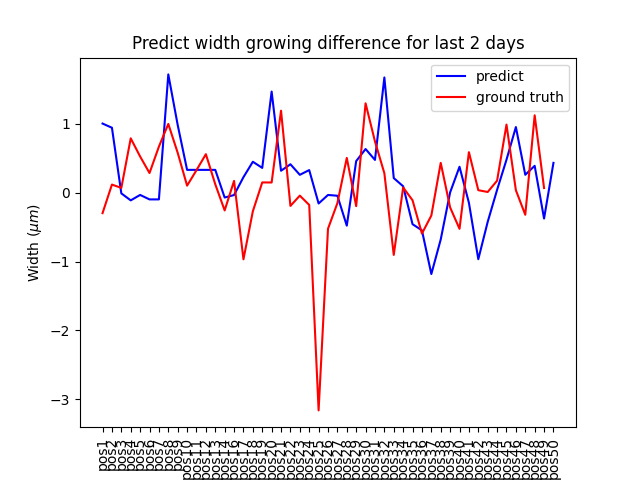

In [113]:
%matplotlib widget
plt.plot(hyphae2p,color="blue",label="predict")
del hyphae2g[14]
plt.plot(hyphae2g,color="red",label="ground truth")
plt.xticks(np.arange(0,len(label2p),1),labels=label2p,rotation = 90)
plt.title("Predict width growing difference for last 2 days")
plt.xlabel("Position")
plt.ylabel("Width ($\mathit{\mu m}$)")
plt.legend()
plt.savefig("plot_data/width growing/20230104_Plate521_13-11(Predict+GroundTruth).png")

In [6]:
%matplotlib widget
plt.plot(hyphae3p,color="blue",label="predict")
del hyphae3g[14]
plt.plot(hyphae3g,color="red",label="ground truth")
plt.xticks(np.arange(0,len(label3p),1),labels=label3p,rotation = 90)
plt.title("Predict width growing difference for 4 days")
plt.xlabel("Position")
plt.ylabel("Width ($\mathit{\mu m}$)")
plt.legend()
plt.savefig("plot_data/width growing/20230104_Plate521_13-9(Predict+GroundTruth).png")

NameError: name 'hyphae3p' is not defined

# Check previous one

In [ ]:
X, y = data("vary_width")
y = y*2
X_train,y_train = data("varying_lum_and_focus_train")
X_test,y_test = data("varying_lum_and_focus_test")
X_combine = np.concatenate([X_train,X_test,X], axis=0)
y_combine = np.concatenate([y_train,y_test,y], axis=0)
X_train, X_test, y_train, y_test = train_test_split(X_combine, y_combine, test_size=0.2, random_state=42,shuffle=True)
X_train, X_val, y_train , y_val   = train_test_split(X_train, y_train, test_size=0.25  , random_state=42,shuffle=True)

In [ ]:
HB_accuracy_old = []
for i in range(len(HB_model)):
    HB_accuracy_old.append([])
BO_accuracy_old = []
for i in range(len(BO_model)):
    BO_accuracy_old.append([])
felix_accuracy_old=[]

def data_preparation(X_test,size=OUTPUTSIZE):
    data_preprocessing = keras.Sequential([
        tf.keras.Input(shape=(IMAGESIZE, 1)),
        center_crop_layer(IMAGESIZE, size)])
    return data_preprocessing(X_test)

from sklearn.utils import resample
import matplotlib.pyplot as plt
n_iterations = 1000
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=50)
    i = 0
    loss, acc = HB_model[i].evaluate(X_bs,y_bs,verbose=1)
    HB_accuracy_old[i].append(acc)
    loss, acc = BO_model[i].evaluate(X_bs,y_bs,verbose=1)
    BO_accuracy_old[i].append(acc)
    for i in range(1,3):
        loss, acc = BO_model[i].evaluate(data_preparation(X_bs,size = data_preparation_value[i]),y_bs,verbose=1)
        BO_accuracy_old[i].append(acc)
        loss, acc = HB_model[i].evaluate(data_preparation(X_bs,size = data_preparation_value[i]),y_bs,verbose=1)
        HB_accuracy_old[i].append(acc)
    loss, acc = felix.evaluate(data_preparation(X_bs,100),y_bs,verbose=1)
    felix_accuracy_old.append(acc)

In [ ]:
import seaborn as sns
# Check MAE
# plot distribution of accuracy
%matplotlib widget
for i in range(len(BO_accuracy_old)):
    sns.kdeplot(BO_accuracy_old[i],label=BO_label[i])
for i in range(len(HB_accuracy_old)):
    sns.kdeplot(HB_accuracy_old[i],label=HB_label[i])
sns.kdeplot(felix_accuracy_old,label="felix model")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("MAE across 1000 bootstrap samples")
plt.xlabel("MAE")
plt.savefig("plot_data/compare_model/20230120 MAE HB vs BO in old data.png", bbox_inches='tight')

In [ ]:
HB_accuracy_RE_old = []
for i in range(len(HB_model)):
    HB_accuracy_RE_old.append([])
BO_accuracy_RE_old = []
for i in range(len(BO_model)):
    BO_accuracy_RE_old.append([])
felix_accuracy_RE_old = []

In [ ]:
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=50)
    i = 0
    RE = np.mean(abs(HB_model[i].predict(X_bs)-y_bs)/y_bs)
    HB_accuracy_RE_old[i].append(RE)
    RE = np.mean(abs(BO_model[i].predict(X_bs)-y_bs)/y_bs)
    BO_accuracy_RE_old[i].append(RE)
    for i in range(1,3):
        RE = np.mean(abs(BO_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)/y_bs)
        BO_accuracy_RE_old[i].append(RE)
        RE = np.mean(abs(HB_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)/y_bs)
        HB_accuracy_RE_old[i].append(RE)
    RE = np.mean(abs(felix.predict(data_preparation(X_bs,100))-y_bs)/y_bs)
    felix_accuracy_RE_old.append(RE)

In [ ]:
# Check RE
%matplotlib widget
for i in range(len(BO_model)):
    sns.kdeplot(BO_accuracy_RE_old[i],label=BO_label[i])
for i in range(len(HB_model)):
    sns.kdeplot(HB_accuracy_RE_old[i],label=HB_label[i])
sns.kdeplot(felix_accuracy_RE_old,label="felix model")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("Relative Error across 1000 bootstrap samples")
plt.xlabel("Relative Error")
plt.savefig("plot_data/compare_model/20230120 RE HB vs BO in old data.png", bbox_inches='tight')

In [ ]:
HB_accuracy_ME_old = []
for i in range(len(HB_model)):
    HB_accuracy_ME_old.append([])
BO_accuracy_ME_old = []
for i in range(len(BO_model)):
    BO_accuracy_ME_old.append([])
felix_accuracy_ME_old = []

In [ ]:
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=50)
    i = 0
    ME = np.mean(HB_model[i].predict(X_bs)-y_bs)
    HB_accuracy_ME_old[i].append(ME)
    ME = np.mean(BO_model[i].predict(X_bs)-y_bs)
    BO_accuracy_ME_old[i].append(ME)
    for i in range(1,3):
        ME = np.mean(BO_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)
        BO_accuracy_ME_old[i].append(ME)
        ME = np.mean(HB_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)
        HB_accuracy_ME_old[i].append(ME)
    ME = np.mean(felix.predict(data_preparation(X_bs,100))-y_bs)
    felix_accuracy_ME_old.append(ME)

In [ ]:
# Check ME
%matplotlib widget
for i in range(len(BO_model)):
    sns.kdeplot(BO_accuracy_ME_old[i],label=BO_label[i])
# for i in range(len(HB_model)):
    # sns.kdeplot(HB_accuracy_ME_old[i],label=HB_label[i])
i=0
sns.kdeplot(HB_accuracy_ME_old[i],label=HB_label[i])
i=2
sns.kdeplot(HB_accuracy_ME_old[i],label=HB_label[i])
sns.kdeplot(felix_accuracy_ME_old,label="felix model")
plt.axvline(0,linestyle="--")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("Mean Error across 1000 bootstrap samples")
plt.xlabel("Mean Error")
plt.savefig("plot_data/compare_model/20230120 ME HB vs BO in old data.png", bbox_inches='tight')

In [ ]:
HB_80.summary()

In [ ]:
BO_100.summary()

In [ ]:
%matplotlib widget
plt.plot(BO_100.predict(data_preparation(X_test,100)),y_test,"o",label="BO_100")
plt.plot(HB_80.predict(data_preparation(X_test,80)),y_test,"o",label="HB_80")
plt.plot((1,18),(1,18))
plt.title("HB vs BO")
plt.xlabel("predict width ($\mathit{\mu m}$)")
plt.ylabel("actual width ($\mathit{\mu m}$)")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.savefig("plot_data/compare_model/20230120 HB vs BO in old data.png", bbox_inches='tight')

In [ ]:
# check max_pooling and average pooling

# Check plate 493

## create dataset

In [ ]:
directory_groundtruths = os.path.join(storage_path)
directory = directory_groundtruths+"/"
update_plate_info(directory)

In [ ]:
folder_df = get_current_folders(directory)
folder_df

In [ ]:
select = folder_df[(folder_df["Plate"] == "493")]

In [ ]:
%matplotlib widget
exp = Experiment(directory)
exp.load(select, suffix="")
exp.load_tile_information(0)
plot_full_image_with_features(exp, 0, 
                              downsizing=10,
                              dilation=1,
                              edges=get_all_edges(exp, 0),
                              nodes=get_all_nodes(exp, 0))

In [ ]:
import networkx as nx
t = 0
G, pos = exp.nx_graph[t], exp.positions[t]
nodes = []
node_label=[]
for path in sorted(nx.shortest_path(G, 37, 73)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 56, 61)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 76, 450)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 531, 450)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 531, 727)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 730, 225)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 37, 25)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
for path in sorted(nx.shortest_path(G, 37, 36)): 
    node_label.append(path)
    nodes.append(Node(path,exp))
%matplotlib widget
plot_full_image_with_features(
    exp,
    t=0,
    downsizing=10,
    nodes = nodes,
)

In [ ]:
%matplotlib widget
df = pd.read_excel(os.path.join(labelme_path,"Fluorescence_ex_Kai-kai_Plate493.xlsx"),engine = "openpyxl",sheet_name="PrinceData",index_col=0)
f = lambda n: generate_index_along_sequence(n, resolution=4, offset=5)
f_profiles = lambda edge: extract_section_profiles_for_edge(
    exp, 0, edge, resolution=5, offset=5, step=1,target_length=120)
for index, row in df.iterrows():
    node,node2 = row["Node"] , row["Node2"]
    try:
        edge = get_edge_from_node_labels(exp, 0, node, node2)
        plot_edge_cropped(edge, 0, mode=3, f=f)
    except AttributeError:
        print(index)

In [ ]:
%matplotlib widget
slices_dict = {}
for index, row in df.iterrows():
    node,node2 = row["Node"] , row["Node2"]
    try:
        edge = get_edge_from_node_labels(exp, 0, node, node2)
        slices, coords1, coords2 = f_profiles(edge)
        slices_dict[index] = slices
    except AttributeError:
        print(index)

In [ ]:
# pos1_bottom-5, pos7-10, pos11-12, pos13-16, pos17-18, pos19-20, pos22-23, pos26-27, pos28-29,
# pos30-32, pos33-34, pos37-39, pos40-42 are on the same segment.
# Need to distinguish them
%matplotlib widget
node,node2 = df.loc["pos37"].to_list()
edge = get_edge_from_node_labels(exp, 0, node, node2)
plot_edge_cropped(edge, 0, mode=3, f=f)

In [ ]:
%matplotlib widget
slices, coords1, coords2 = f_profiles(edge)
# plt.imshow(slices[:len(slices)])
plt.imshow(slices[:])

In [ ]:
collect_slice = []
collect_label = []
def divide_slice(slices, pos, total):
    return slices[(pos-1)*len(slices)//total : pos * len(slices)//total]
for key in slices_dict.keys():
    slices = slices_dict[key]
    # pos40-42
    if key == "pos40":
        slices = divide_slice(slices, 3, 3)
    if key == "pos41":
        slices = divide_slice(slices, 2, 3)
    if key == "pos42":
        slices = divide_slice(slices, 1, 3)  
    
    # pos37-39
    if key == "pos37":
        slices = divide_slice(slices, 3, 3)
    if key == "pos38":
        slices = divide_slice(slices, 2, 3)
    if key == "pos39":
        slices = divide_slice(slices, 1, 3)
    
    # pos33-34
    if key == "pos33":
        slices = divide_slice(slices, 2, 2)
    if key == "pos34":
        slices = divide_slice(slices, 1, 2)
    
    # pos30-32
    if key == "pos30":
        slices = slices[175:]
    if key == "pos31":
        slices = divide_slice(slices, 2, 2)
    if key == "pos32":
        slices = divide_slice(slices, 1, 2)
    
    # pos28-29
    if key == "pos28":
        slices = divide_slice(slices, 1, 2)
    if key == "pos29":
        slices = divide_slice(slices, 2, 2)
    
    # pos26-27
    if key == "pos26":
        slices = slices[:100]
    if key == "pos27":
        slices = slices[100:]
        
    # pos22-23
    if key == "pos22":
        slices = divide_slice(slices, 1, 2)
    if key == "pos23":
        slices = divide_slice(slices, 2, 2)
    
    # pos19-20
    if key == "pos19":
        slices = slices[:70]
    if key == "pos20":
        slices = slices[70:]
    
    # pos17-18
    if key == "pos17":
        slices = slices[75:135]
    if key == "pos18":
        slices = slices[135:] 
        
    # pos13-16
    if key == "pos13":
        slices = divide_slice(slices, 1, 4)
    if key == "pos14":
        slices = divide_slice(slices, 2, 4)
    if key == "pos15":
        slices = divide_slice(slices, 3, 4)
    if key == "pos16":
        slices = divide_slice(slices, 4, 4)
    
    # pos11-12
    if key == "pos11":
        slices = slices[:40]
    if key == "pos12":
        slices = slices[40:100]
    
    # pos7-10
    if key == "pos7":
        slices = divide_slice(slices, 1, 4)
    if key == "pos8":
        slices = divide_slice(slices, 2, 4)
    if key == "pos9":
        slices = divide_slice(slices, 3, 4)
    if key == "pos10":
        slices = divide_slice(slices, 4, 4)  
        
    # pos1-pos5
    if key == "pos1_bottom":
        slices = slices[:250]
        slices = divide_slice(slices, 1, 5)
    if key == "pos2":
        slices = slices[:250]
        slices = divide_slice(slices, 2, 5)
    if key == "pos3":
        slices = slices[:250]
        slices = divide_slice(slices, 3, 5)
    if key == "pos4":
        slices = slices[:250]
        slices = divide_slice(slices, 4, 5)
    if key == "pos5":
        slices = slices[:250]
        slices = divide_slice(slices, 5, 5)
    for i in range(1,5):
        collect_slice.extend(slices[i*len(slices)//5 : i*len(slices)//5+1])
    collect_label.extend([width_dict[key]]*4)

In [ ]:
%matplotlib widget
segment = get_labelme_segments(os.path.join(labelme_path,"20230111_Plate493/","extract_file"))
width_dict,width_std_dict= compute_width_from_segment(segment)
width = [i*2 for i in list(width_dict.values())]
plt.hist(width,color="blue")
plt.title("Ground truth distribution Plate493 Jan 11")
plt.xlabel("width ($\mathit{\mu m}$)")
plt.ylabel("amount")
plt.show()

In [ ]:
slice_array = np.array(collect_slice)
label_array = np.array(collect_label)
print(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")

In [ ]:
os.mkdir(os.path.join(dataset_path, "20230111_Plate493"))
cv2.imwrite(os.path.join(dataset_path, "20230111_Plate493","slices.png"), slice_array)
with open(os.path.join(dataset_path, "20230111_Plate493","labels.npy"), "wb") as f:
    np.save(f, label_array)
with open(os.path.join(dataset_path, "20230111_Plate493","info.txt"), "w") as f:
    f.write(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")
    f.write('\nPlate number: 493\nStrain: Agg\nCrossdate: 06/12/22\nPrince position: 24\nPRINCE FULL DATA: 20230111_1248_Plate24\nNotice: bin2. The width should be multiplied by 2.')

## Load model and check accuracy

In [ ]:
X_test,y_test = data("20230111_Plate493")
y_test = y_test*2
X_test.shape,y_test.shape

In [ ]:
%matplotlib widget
plt.hist(y_test,color="blue")
plt.title("Ground truth distribution Plate493 Jan 11")
plt.xlabel("width ($\mathit{\mu m}$)")
plt.ylabel("amount")
plt.show()

In [ ]:
HB_accuracy = []
for i in range(len(HB_model)):
    HB_accuracy.append([])
BO_accuracy = []
for i in range(len(BO_model)):
    BO_accuracy.append([])
felix_accuracy=[]

def data_preparation(X_test,size=OUTPUTSIZE):
    data_preprocessing = keras.Sequential([
        tf.keras.Input(shape=(IMAGESIZE, 1)),
        center_crop_layer(IMAGESIZE, size)])
    return data_preprocessing(X_test)

from sklearn.utils import resample
import matplotlib.pyplot as plt
n_iterations = 1000
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=10)
    i = 0
    loss, acc = HB_model[i].evaluate(X_bs,y_bs,verbose=1)
    HB_accuracy[i].append(acc)
    loss, acc = BO_model[i].evaluate(X_bs,y_bs,verbose=1)
    BO_accuracy[i].append(acc)
    for i in range(1,3):
        loss, acc = BO_model[i].evaluate(data_preparation(X_bs,size = data_preparation_value[i]),y_bs,verbose=1)
        BO_accuracy[i].append(acc)
        loss, acc = HB_model[i].evaluate(data_preparation(X_bs,size = data_preparation_value[i]),y_bs,verbose=1)
        HB_accuracy[i].append(acc)
    loss, acc = felix.evaluate(data_preparation(X_bs,100),y_bs,verbose=1)
    felix_accuracy.append(acc)

In [ ]:
import seaborn as sns
# Check MAE
# plot distribution of accuracy
%matplotlib widget
for i in range(len(BO_accuracy)):
    sns.kdeplot(BO_accuracy[i],label=BO_label[i])
for i in range(len(HB_accuracy)):
    sns.kdeplot(HB_accuracy[i],label=HB_label[i])
sns.kdeplot(felix_accuracy,label="felix model")
# plt.xlim(0,5)
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("MAE across 1000 bootstrap samples")
plt.xlabel("MAE")
plt.savefig("plot_data/compare_model/20230120 MAE HB vs BO in plate493.png", bbox_inches='tight')

In [ ]:
HB_accuracy_RE = []
for i in range(len(HB_model)):
    HB_accuracy_RE.append([])
BO_accuracy_RE = []
for i in range(len(BO_model)):
    BO_accuracy_RE.append([])
felix_accuracy_RE = []

In [ ]:
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=10)
    i = 0
    RE = np.mean(abs(HB_model[i].predict(X_bs)-y_bs)/y_bs)
    HB_accuracy_RE[i].append(RE)
    RE = np.mean(abs(BO_model[i].predict(X_bs)-y_bs)/y_bs)
    BO_accuracy_RE[i].append(RE)
    for i in range(1,3):
        RE = np.mean(abs(BO_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)/y_bs)
        BO_accuracy_RE[i].append(RE)
        RE = np.mean(abs(HB_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)/y_bs)
        HB_accuracy_RE[i].append(RE)
    RE = np.mean(abs(felix.predict(data_preparation(X_bs,100))-y_bs)/y_bs)
    felix_accuracy_RE.append(RE)

In [ ]:
# Check RE
%matplotlib widget
for i in range(len(BO_model)):
    sns.kdeplot(BO_accuracy_RE[i],label=BO_label[i])
for i in range(len(HB_model)):
    sns.kdeplot(HB_accuracy_RE[i],label=HB_label[i])
sns.kdeplot(felix_accuracy_RE,label="felix model")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("Relative Error across 1000 bootstrap samples")
plt.xlabel("Relative Error")
plt.savefig("plot_data/compare_model/20230120 RE HB vs BO in plate493.png", bbox_inches='tight')

In [ ]:
%matplotlib widget
fig = plt.figure(figsize=(30, 4))
total_model = len(HB_model)+len(BO_model)+1
i=0
compare_different_model(HB_model[i], X_test, y_test, x_range=[0,20], set_title=HB_label[i], total=total_model, plot_number=i+1)
compare_different_model(BO_model[i], X_test, y_test, x_range=[0,20], set_title=BO_label[i], total=total_model, plot_number=len(HB_model)+1)
for i in range(1,len(HB_model)):
    compare_different_model(HB_model[i], data_preparation(X_test,data_preparation_value[i]), y_test, x_range=[0,20], set_title=HB_label[i], total=total_model, plot_number=i+1)
for j in range(1,len(BO_model)):
    compare_different_model(BO_model[j], data_preparation(X_test,data_preparation_value[j]), y_test, x_range=[0,20], set_title=BO_label[j], total=total_model, plot_number=len(HB_model)+j+1)
compare_different_model(felix, data_preparation(X_test,100), y_test, x_range=[0,20], set_title="felix_model", total=total_model, plot_number=total_model)
plt.savefig("plot_data/compare_model/20230120 HB vs BO in plate493.png", bbox_inches='tight')

In [ ]:
%matplotlib widget
plt.plot(BO_100.predict(data_preparation(X_test,100)),y_test,"o")
plt.plot((1,18),(1,18))
plt.title("BO 100")
plt.xlabel("predict width ($\mathit{\mu m}$)")
plt.ylabel("actual width ($\mathit{\mu m}$)")
plt.legend()
plt.show()

In [ ]:
%matplotlib widget
plt.plot(felix.predict(data_preparation(X_test,100)),y_test,"o")
plt.plot((1,18),(1,18))
plt.title("Felix model")
plt.xlabel("predict width ($\mathit{\mu m}$)")
plt.ylabel("actual width ($\mathit{\mu m}$)")
plt.legend()
plt.show()
# plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
# plt.savefig("plot_data/compare_model/20230120 HB vs BO in old data.png", bbox_inches='tight')

In [ ]:
# check ME
HB_accuracy_ME = []
for i in range(len(HB_model)):
    HB_accuracy_ME.append([])
BO_accuracy_ME = []
for i in range(len(BO_model)):
    BO_accuracy_ME.append([])
felix_accuracy_ME = []

In [ ]:
for _ in range(n_iterations):
    X_bs, y_bs = resample(X_test, y_test, replace=True,n_samples=10)
    i = 0
    ME = np.mean(HB_model[i].predict(X_bs)-y_bs)
    HB_accuracy_ME[i].append(ME)
    ME = np.mean(BO_model[i].predict(X_bs)-y_bs)
    BO_accuracy_ME[i].append(ME)
    for i in range(1,3):
        ME = np.mean(BO_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)
        BO_accuracy_ME[i].append(ME)
        ME = np.mean(HB_model[i].predict(data_preparation(X_bs,data_preparation_value[i]))-y_bs)
        HB_accuracy_ME[i].append(ME)
    ME = np.mean(felix.predict(data_preparation(X_bs,100))-y_bs)
    felix_accuracy_ME.append(ME)

In [ ]:
# Check ME
%matplotlib widget
for i in range(len(BO_model)):
    sns.kdeplot(BO_accuracy_ME[i],label=BO_label[i])
for i in range(len(HB_model)):
    sns.kdeplot(HB_accuracy_ME[i],label=HB_label[i])
sns.kdeplot(felix_accuracy_ME,label="felix model")
plt.legend(bbox_to_anchor=(1.03, 1),loc='upper left')
plt.title("Mean Error across 1000 bootstrap samples")
plt.xlabel("Mean Error")
plt.savefig("plot_data/compare_model/20230120 ME HB vs BO in plate 493.png", bbox_inches='tight')

In [ ]:
HB_80.summary()

In [ ]:
BO_100.summary()

## Useful code

In [ ]:
def get_slices_dict(df,exp,target_length=120,output_type="check"):
    slices_dict = {}
    f = lambda n: generate_index_along_sequence(n, resolution=4, offset=5)
    f_profiles = lambda edge: extract_section_profiles_for_edge(
        exp, 0, edge, resolution=5, offset=5, step=1,target_length=target_length)
    for index, row in df.iterrows():
        node,node2 = row["Node"] , row["Node2"]
        try:
            edge = get_edge_from_node_labels(exp, 0, node, node2)
            if output_type == "check":
                plot_edge_cropped(edge, 0, mode=3, f=f)
            if output_type == "data":
                slices, coords1, coords2 = f_profiles(edge)
                slices_dict[index] = slices
        except AttributeError:
            print(index)
    return slices_dict

def make_dataset(dataset_path,file_name,slice_array,label_array,plate_number,strain,crossdate,prince_position,bin_number):
    os.mkdir(os.path.join(dataset_path, str(file_name)))
    cv2.imwrite(os.path.join(dataset_path, str(file_name),"slices.png"), slice_array)
    with open(os.path.join(dataset_path, str(file_name),"labels.npy"), "wb") as f:
        np.save(f, label_array)
    with open(os.path.join(dataset_path, str(file_name),"info.txt"), "w") as f:
        f.write(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")
        f.write(f'\nPlate number {plate_number}\nStrain: {strain}\nCrossdate: {crossdate}\nPrince position: {prince_position}\nNotice: It is bin {bin_number}. The width should be multiplied by {bin_number}.')
        
def load_model_list(model_path,model_list):
    from keras import backend
    output, learning_rate=[], []
    for model_name in model_list:
        if model_name != "felix":
            model = load_model(model_path,model_name)
            output.append(model)
            learning_rate.append(backend.get_value(model.optimizer.lr))
        else:
            model = load_model(model_path,"default_model")
            output.append(model)
            learning_rate.append(backend.get_value(model.optimizer.lr))
    return output, learning_rate

def plot_seperate_dataset(model,dataset:str,value_size:int,crop_value:int):
    X, y = data(dataset)
    y = y * value_size
    X_train_iter, X_test_iter, y_train_iter, y_test_iter = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True)
    X_test = data_preparation(X_test_iter,crop_value)
    plt.plot(model.predict(X_test), y_test_iter,"o",label = dataset)
    return plt